# Bat Detection

# 1. Faster R-CNN

### Specify path of input video

In [1]:
batter_videos = "/Volumes/Nina Backup/high_quality_testing/batter/"
name = "#1 Kyle Zirbes.mp4"

# Specify swing frames to get the detection rate of faster R-CNN and FMO-C for the relevant frames
SWING_START = 100
SWING_END = 130

INPUT_VIDEO_PATH = batter_videos+ name

# threshold for faster R-CNN: minimum output of the network to classify the object as a bat
SCORE_THRESH = 0.6

# Joints needed for wrist etc
PATH_JOINTS = "../train_data/batter_hq_joints/"+ name[:-4]+".json"

SHOW_IMAGES = True

### Imports

In [2]:
import numpy as np
import os
import six.moves.urllib as urllib
import sys
import tarfile
import tensorflow as tf
import zipfile
from os import listdir
import time
import cv2
import json

from collections import defaultdict
from io import StringIO
from matplotlib import pyplot as plt
from PIL import Image

import math
import matplotlib
from matplotlib import pyplot as plt
from skvideo import io

%matplotlib inline

/Users/ninawiedemann/anaconda/lib/python3.5/site-packages/skvideo/__init__.py:356: UserWarning: avconv/avprobe not found in path: 
  warnings.warn("avconv/avprobe not found in path: " + str(path), UserWarning)


### Add paths to directories for faster RCNN

In [3]:
# PATH_TENSORFLOW_API = "models/research/"
PATH_TENSORFLOW_API = "models/research/object_detection"

MODEL_NAME = "rfcn_resnet101_coco_11_06_2017"

### AVAILABLE MODELS:
# fifth_best: 'ssd_mobilenet_v1_coco_11_06_2017'
# fourth_best: "rfcn_resnet101_coco_11_06_2017"
# third_best: "faster_rcnn_resnet101_coco_11_06_2017"
# second_best: "faster_rcnn_inception_resnet_v2_atrous_coco_11_06_2017"
# best ging nicht: "faster_rcnn_nas_coco_24_10_2017"

MODEL_FILE = MODEL_NAME + '.tar.gz'
DOWNLOAD_BASE = 'http://download.tensorflow.org/models/object_detection/'

# Path to frozen detection graph. This is the actual model that is used for the object detection.
PATH_TO_CKPT = os.path.join(PATH_TENSORFLOW_API, MODEL_NAME, 'frozen_inference_graph.pb')

# List of the strings that is used to add correct label for each box.
PATH_TO_LABELS = os.path.join(PATH_TENSORFLOW_API, 'data', 'mscoco_label_map.pbtxt')

# Size, in inches, of the output images.
IMAGE_SIZE = (12, 8)
NUM_CLASSES = 90

# This is needed since all models and utils code is stored in the object_detection folder of the tensorflow api
sys.path.append(PATH_TENSORFLOW_API)

from utils import label_map_util

from utils import visualization_utils as vis_util

### Download Model - does not need to be executed for most of the models because already loaded

In [4]:
if not os.path.exists(os.path.join(PATH_TENSORFLOW_API, MODEL_NAME)):
    opener = urllib.request.URLopener()
    opener.retrieve(DOWNLOAD_BASE + MODEL_FILE, MODEL_FILE)
    tar_file = tarfile.open(MODEL_FILE)
    for file in tar_file.getmembers():
        file_name = os.path.basename(file.name)
        if 'frozen_inference_graph.pb' in file_name:
            tar_file.extract(file, PATH_TENSORFLOW_API)

### Load a (frozen) Tensorflow model into memory.

In [4]:
detection_graph = tf.Graph()
with detection_graph.as_default():
    od_graph_def = tf.GraphDef()
    with tf.gfile.GFile(PATH_TO_CKPT, 'rb') as fid:
        serialized_graph = fid.read()
        od_graph_def.ParseFromString(serialized_graph)
        tf.import_graph_def(od_graph_def, name='')

### Loading label map
Label maps map indices to category names, so that when our convolution network predicts `5`, we know that this corresponds to `airplane`.  Here we use internal utility functions, but anything that returns a dictionary mapping integers to appropriate string labels would be fine

In [5]:
label_map = label_map_util.load_labelmap(PATH_TO_LABELS)
categories = label_map_util.convert_label_map_to_categories(label_map, max_num_classes=NUM_CLASSES, use_display_name=True)
category_index = label_map_util.create_category_index(categories)

haaalo <class 'object_detection.protos.string_int_label_map_pb2.StringIntLabelMap'> 


### Run Faster R-CNN on the video

Set the parameter every_x_frame to specify at which rate faster R-CNN should be run (if every_x_frame=10, only every 10th frame is tested)

Time for one image:  27.658737897872925


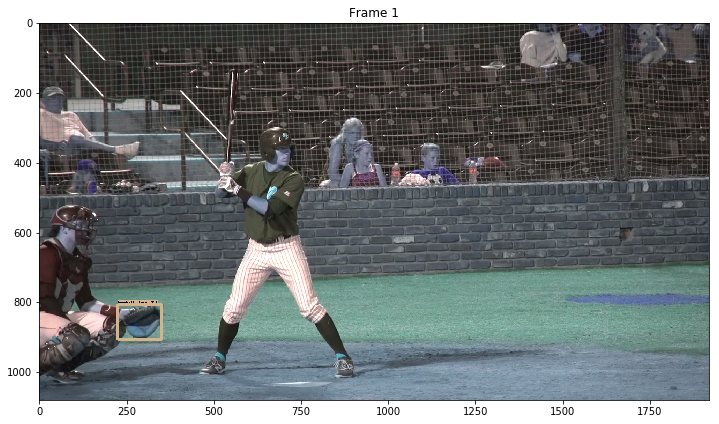

Time for one image:  11.802403926849365


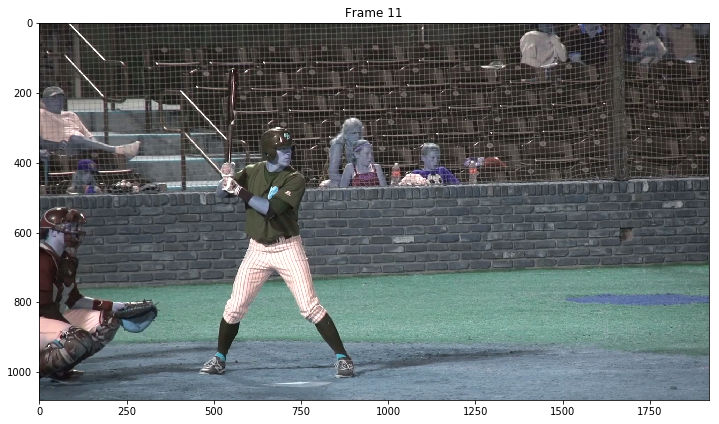

KeyboardInterrupt: 

In [6]:
cap = cv2.VideoCapture(INPUT_VIDEO_PATH)

# Specify if faster R-CNN should only be applied on every x frame, and if only the swing should be evaluated
every_x_frame = 10
start_at_SWING_START = False
end_at_SWING_END = False

if start_at_SWING_START:
    cap.set(cv2.CAP_PROP_POS_FRAMES, SWING_START)

assert os.path.exists(INPUT_VIDEO_PATH), "INVALID INPUT VIDEO FILE"

output_dic = {}
batBox = []
gloveBox = []

with detection_graph.as_default():
    with tf.Session(graph=detection_graph) as sess:
        # Definite input and output Tensors for detection_graph
        image_tensor = detection_graph.get_tensor_by_name('image_tensor:0')
        # Each box represents a part of the image where a particular object was detected.
        detection_boxes = detection_graph.get_tensor_by_name('detection_boxes:0')
        # Each score represent how level of confidence for each of the objects.
        # Score is shown on the result image, together with the class label.
        detection_scores = detection_graph.get_tensor_by_name('detection_scores:0')
        detection_classes = detection_graph.get_tensor_by_name('detection_classes:0')
        num_detections = detection_graph.get_tensor_by_name('num_detections:0')
        if start_at_SWING_START:
            frame_count = SWING_START
        else:
            frame_count = 0
        if end_at_SWING_END:
            end = SWING_END
        else:
            end = np.inf
        while frame_count<end:
            ret, image_np = cap.read()
            if image_np is None:
                break
            shape = image_np.shape
            frame_count+=1
            
            # Only every x-th frame
            if (frame_count-1)%every_x_frame!=0:
                continue
                
            # Expand dimensions since the model expects images to have shape: [1, None, None, 3]
            image_np_expanded = np.expand_dims(image_np, axis=0)
            
            # Actual detection.
            tic = time.time()
            (boxes, scores, classes, num) = sess.run(
              [detection_boxes, detection_scores, detection_classes, num_detections],
              feed_dict={image_tensor: image_np_expanded})
            
            print("Time for one image: ", time.time()-tic)
            
            # select the results where the object class is either bat or glove
            index = np.union1d(np.where(np.squeeze(classes)==40)[0],np.where(np.squeeze(classes)==39)[0]) #np.where(np.squeeze(classes)!=1)[0]
            classes = np.squeeze(classes)[index]
            scores = np.squeeze(scores)[index]
            boxes_normalized = np.squeeze(boxes)[index]
            
            # bounding boxes are outputted from the faster R-CNN in a normalized form, multiply with frame
            boxes = boxes_normalized * np.array([[shape[0],shape[1],shape[0], shape[1]] for _ in range(len(boxes))])
            num = len(classes)
            
            # save bounding boxes for bat and gloves
            inner_dic = {}
            for i, s in enumerate(scores):
                if s>SCORE_THRESH:
                    if classes[i]==39:
                        class_name = "bat"
                        aabb = boxes[i].astype(int)
                        batBox.append([np.array([[aabb[1], aabb[0]], [aabb[3], aabb[2]]]), frame_count])
                    else:
                        aabb = boxes[i].astype(int)
                        gloveBox.append([np.array([aabb[:2],aabb[2:]]), frame_count])
                        class_name = "glove"
                    inner_dic[class_name] = {"score":float(s), "box":boxes[i].tolist()}
            output_dic[str(frame_count).zfill(4)] = inner_dic
            
            # Visualization of the results of a detection.
            if SHOW_IMAGES:
                vis_util.visualize_boxes_and_labels_on_image_array(
                  image_np,
                  boxes_normalized, classes.astype(np.int32), scores,
                  category_index,
                  use_normalized_coordinates=True,
                    min_score_thresh = SCORE_THRESH,
                    max_boxes_to_draw = 100,
                  line_thickness=8)
                plt.figure(figsize=IMAGE_SIZE)
                plt.imshow(image_np)
                plt.title("Frame "+str(frame_count))
                plt.show()
                #if SAVE_IMAGES:
                 #   cv2.imwrite(TEST_OUT_PATH+image_path.split("/")[-1], image_np)
                    #plt.savefig()
batBox = np.array(batBox)
oldBatBox = batBox
gloveBox = np.array(gloveBox)

print(batBox)

with open(os.path.join("outputs", name[:-4]+ "_bat_and_glove_aabbs.json"), "w") as outfile:
    json.dump(output_dic, outfile)

### Detection rates:

In [22]:
if len(gloveBox)!=0:
    frames_detected = gloveBox[:,1]
    frames_after_start = frames_detected[frames_detected>SWING_START]
    frames_before_end = frames_after_start[frames_after_start<SWING_END]
    detection_rate_glove = len(frames_before_end)/float((SWING_END- SWING_START)//every_x_frame)
    print("Faster R-CNN detected the GLOVE in ", detection_rate_glove*100, "% of the swing frames frames")
else:
    print("No glove detected")
    
frames_detected = batBox[:,1]
frames_after_start = frames_detected[frames_detected>SWING_START]
frames_before_end = frames_after_start[frames_after_start<SWING_END]
detection_rate_bat = len(frames_before_end)/float((SWING_END- SWING_START)//every_x_frame)
print("Faster R-CNN detected the BAT in ", detection_rate_bat*100, "% of the swing frames frames")



Faster R-CNN detected the GLOVE in  13.333333333333334 % frames
Faster R-CNN detected the BAT in  23.333333333333332 % frames


# 2. FMO-C

In [42]:
# Load ball_detection code from the parent directory (because it is used for object detection and event detection)
import sys
sys.path.append("..")
from fmo_detection import detect_ball, plot_trajectory, from_json

### Run FMO-C --> output candidates per frame

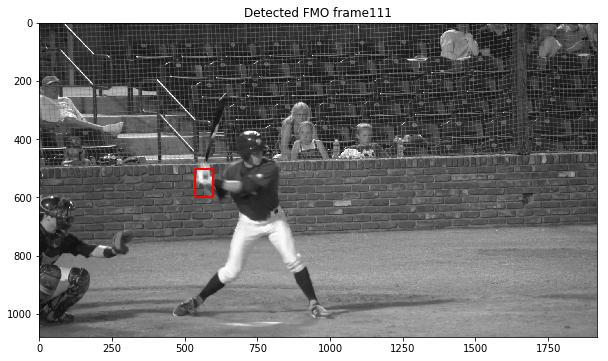

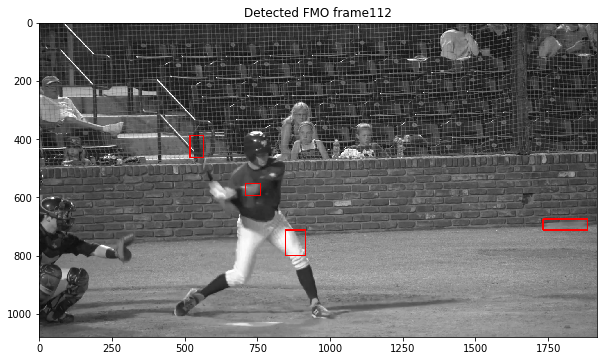

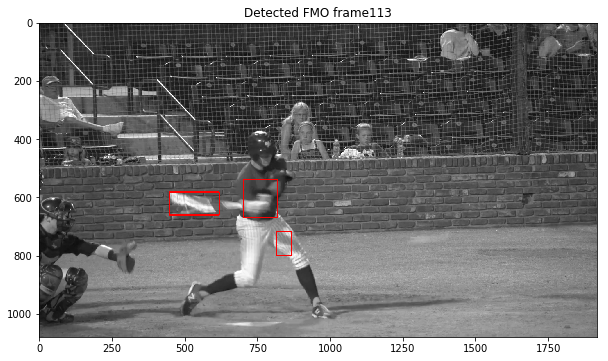

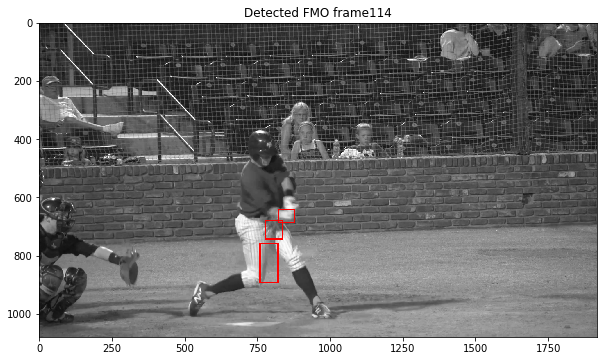

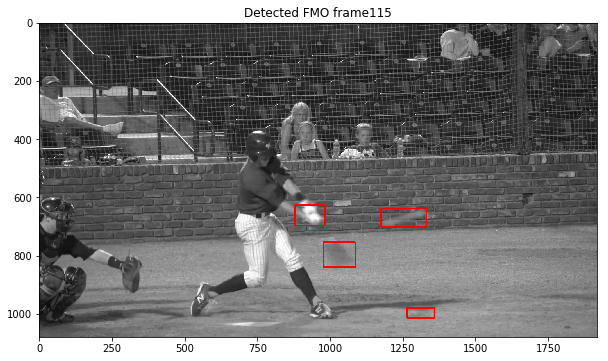

...

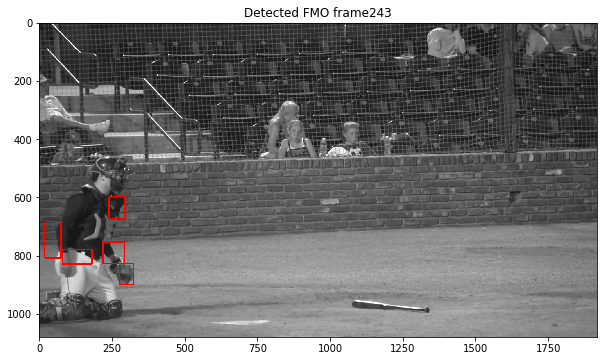

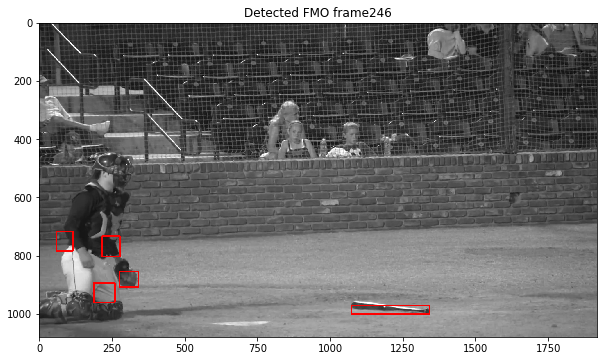

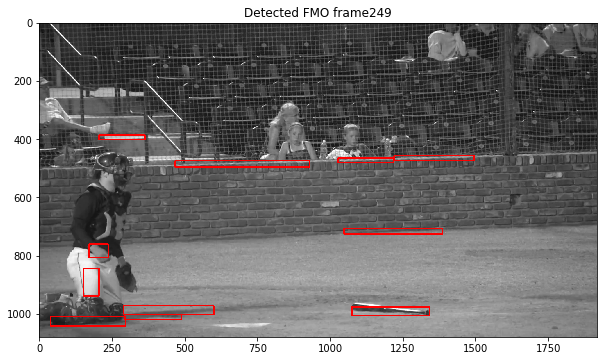

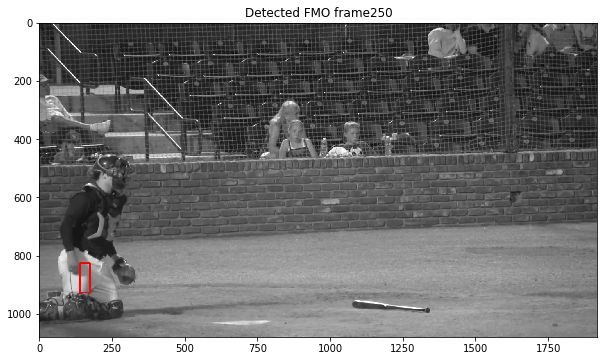

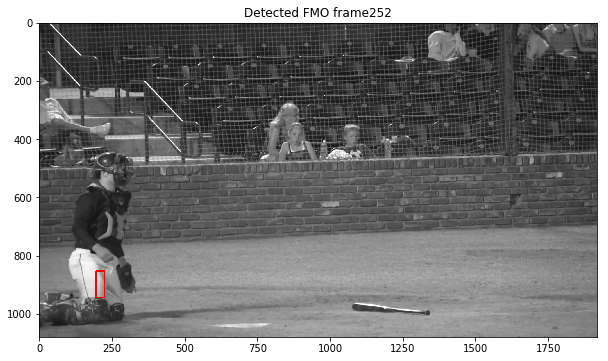

In [76]:
MIN_AREA = 1000
assert os.path.exists(INPUT_VIDEO_PATH), "INVALID INPUT VIDEO FILE"
_, _, _, candidates_per_frame = detect_ball(INPUT_VIDEO_PATH, joints_array = None, plotting=True, min_area=MIN_AREA, every_x_frame=1) #400

# 3. Combine both

In [77]:
### THRESHOLDS ###

# Take candidate as the new bat if it is less than MAX_DIST_THRESH away from the previous bat detection
# --> to have a resolution independent threshold, two times the length of a bat serves as the threshold
MAX_DIST_THRESH = max(np.linalg.norm(batBox[i,0][0]-batBox[i,0][1]) for i in range(len(batBox)))
print("MAX_DIST_THRESH", MAX_DIST_THRESH)

# Merge two candidates if they are very close to each other, because sometimes the bat is split into two parts
# Here, also a threshold dependent on the bat length is taken
OVERLAPPING_THRESH = 0.05*MAX_DIST_THRESH
print("OVERLAPPING_THRESH", OVERLAPPING_THRESH)

# set plotting true if the output of fmo c should be plotted on the video
PLOTTING = True

MAX_DIST_THRESH 312.694739323
OVERLAPPING_THRESH 15.6347369661


### Functions to merge overlapping boxes and find closest box

In [78]:
def areOverlapping(recA, recB):
    """
    tests if two FMO candidates are overlapping
    """
    if (recA[1][0]+OVERLAPPING_THRESH<recB[0][0] or recB[1][0]+OVERLAPPING_THRESH<recA[0][0] or 
        recA[1][1]+OVERLAPPING_THRESH<recB[0][1] or recB[1][1]+OVERLAPPING_THRESH<recA[0][1]):
        return False
    else:
        return True

def combineOverlapping(cands):
    """
    merge two candidates if they are overlapping
    """
    for i in range(len(cands)):
        recA = cands[i]
        for j in range(len(cands)):
            recB = cands[j]
            if i != j:
                if areOverlapping(recA,recB):
                    recComb = ((min(recA[0][0],recB[0][0]), min(recA[0][1],recB[0][1])),(max(recA[1][0],recB[1][0]),max(recA[1][1],recB[1][1])))
                    cands[i] = recComb
                    cands[j] = recComb
    return cands
                    
def closestBox(cands, batLoc, threshold_max_dist):
    """
    find closest candidate dependent on the last bat detection batLoc
    """
    minInd = -1
    for i in range(len(cands)):
        candBat = np.array(cands[i][:2])
        candDist = np.linalg.norm((batLoc[0]+batLoc[1])/2 - (candBat[0]+candBat[1])/2)
        # print("distance", candDist)
        if candDist < threshold_max_dist:
            # candidate closer to threshold found, keep on searching for closer ones
            threshold_max_dist = candDist
            minInd = i
    if minInd != -1:
        return np.array(cands[minInd][:2])
    else:
        return np.zeros([2,2])   # bat is set as missing values if no candidate is sufficiently close       

### Take the candidats_per_frame of FMO-C and select the closest candidate to the previous bat detection for each frame 

In [79]:
# Threshold: two times the maximum length of the bat (MAX_DIST_THRESH)

frame_count = 0
currentBat = batBox[0,0]

onlyBat = batBox.tolist()

for i, cand_list in enumerate(candidates_per_frame):
    # print(frame_count, len(candidates_per_frame))
    # cand_list = candidates_per_frame[frame_count]
    candidates = [[cand.bbox[:2], cand.bbox[2:]] for cand in cand_list]
    if len(candidates)>1:
        candidates = combineOverlapping(candidates)
        # print(candidates)
    
    if len(candidates)>0:
        # print("candidates", candidates, "currentBat", currentBat)
        newBox = closestBox(candidates, currentBat, MAX_DIST_THRESH)
        # print(newBox)
        if newBox.any():
            onlyBat.append([np.array(newBox), int(frame_count)])
            currentBat = newBox
        
    frame_count+=1
    
# print("-----------------")
print("output: [first point of rectange, second point of rectangle, frame]" )
onlyBat = np.array(onlyBat)
print(onlyBat)


output: [first point of rectange, second point of rectangle, frame]
[[array([[506, 145],
       [613, 387]]) 101]
 [array([[448, 150],
       [619, 405]]) 101]
 [array([[536, 145],
       [619, 340]]) 101]
 [array([[494, 136],
       [627, 419]]) 102]
 [array([[509, 162],
       [635, 389]]) 103]
 [array([[550, 178],
       [669, 347]]) 105]
 [array([[554, 263],
       [664, 468]]) 109]
 [array([[685, 754],
       [881, 932]]) 130]
 [array([[536, 502],
       [598, 598]], dtype=int32) 109]
 [array([[519, 386],
       [565, 462]], dtype=int32) 110]
 [array([[448, 581],
       [620, 660]], dtype=int32) 111]
 [array([[779, 641],
       [879, 742]], dtype=int32) 112]
 [array([[881, 626],
       [983, 696]], dtype=int32) 113]
 [array([[ 876,  583],
       [1088,  676]], dtype=int32) 114]
 [array([[ 910,  552],
       [1055,  617]], dtype=int32) 115]
 [array([[ 916,  500],
       [1047,  566]], dtype=int32) 116]
 [array([[ 992,  359],
       [1187,  507]], dtype=int32) 117]
 [array([[845, 25

### Detection rate FMO-C:

In [80]:
frames_detected_fmo = onlyBat[:,1]
frames_after_start_fmo = frames_detected_fmo[frames_detected_fmo>SWING_START]
frames_before_end_fmo = frames_after_start_fmo[frames_after_start_fmo<SWING_END]
frames_only_fmo = []
nr_already_rcnn  = 0
for frame in frames_before_end_fmo:
    if frame not in frames_before_end:
        frames_only_fmo.append(frame)
    else:
        nr_already_rcnn+=1
detection_rate_bat_fmo = len(frames_before_end_fmo)/float((SWING_END-SWING_START)//every_x_frame)
print("frames during swing detected by FMO-C:", frames_only_fmo)
print("Faster R-CNN detected the BAT in ", detection_rate_bat_fmo*100, "% frames")

frames during swing detected by FMO-C: [110, 111, 112, 113, 114, 115, 116, 117, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129]
Faster R-CNN detected the BAT in  90.0 % frames


# 4. Find tip and base using the wrist

### Load json file with joints of target player

In [82]:
coords = from_json(PATH_JOINTS)

### Get array of wrist coordinates

In [83]:
wristTracker = []
for i in range(len(coords)):
    if ((not coords[i][3].any()) and (not coords[i][5].any())):
        wristTracker.append(wristTracker[i-1])
    else:
        if (not coords[i][5].any()):
            wristTracker.append(coords[i][3])
        elif (not coords[i][3].any()):
            wristTracker.append(coords[i][5])
        else:
            wristTracker.append((coords[i][3]+coords[i][5])/2)
    
wristTracker = np.array(wristTracker)

### Concatenate both outputs

In [84]:
# combBat = np.concatenate((batBox, blurBat), axis = 0)
# combBat = combBat[combBat[:,1].argsort()]
combBat = onlyBat[onlyBat[:,1].argsort()]
#print(combBat)

### Locate tip and base of the bat, using the wrist

In [85]:
batTip = []
batBase = []
# wristBase = []
for i in range(len(combBat)):
    frame = combBat[i,1]
#     wristBase.append([wristTracker[frame][0], wristTracker[frame][1],frame])
    if abs(combBat[i,0][0,0]-wristTracker[frame][1]) > abs(combBat[i,0][1,0]-wristTracker[frame][1]):
        xTipInd = 0
    else:
        xTipInd = 1
    if abs(combBat[i,0][0,1]-wristTracker[frame][0]) > abs(combBat[i,0][1,1]-wristTracker[frame][0]):
        yTipInd = 0
    else:
        yTipInd = 1
    batTip.append([combBat[i,0][xTipInd,0],combBat[i,0][yTipInd,1], frame])
    batBase.append([combBat[i,0][abs(xTipInd-1),0],combBat[i,0][abs(yTipInd-1),1], frame])

tip = np.array(batTip)
base = np.array(batBase)

### Interpolation

In [107]:
## GLOVE
new_format = []
for x in gloveBox:
    coords = x[0].flatten().tolist()
    coords.append(x[1])
    new_format.append(coords)

new_format = np.array(new_format)
new_inds = np.arange(new_format[0,4], new_format[-1,4]+1, 1)
glove_interpolated = []
for i in range(4):
    sequ = np.interp(new_inds, new_format[:,4], new_format[:,i])
    glove_interpolated.append(sequ)
glove_interpolated = np.swapaxes(np.array(glove_interpolated), 0,1)
print(glove_interpolated)

[[  806.           225.           906.           352.        ]
 [  805.9          224.575        905.775        351.225     ]
 [  805.8          224.15         905.55         350.45      ]
 [  805.7          223.725        905.325        349.675     ]
 [  805.6          223.3          905.1          348.9       ]
 [  805.5          222.875        904.875        348.125     ]
 [  805.4          222.45         904.65         347.35      ]
 [  805.3          222.025        904.425        346.575     ]
 [  805.2          221.6          904.2          345.8       ]
 [  805.1          221.175        903.975        345.025     ]
 [  805.           220.75         903.75         344.25      ]
 [  804.9          220.325        903.525        343.475     ]
 [  804.8          219.9          903.3          342.7       ]
 [  804.7          219.475        903.075        341.925     ]
 [  804.6          219.05         902.85         341.15      ]
 [  804.5          218.625        902.625        340.37

In [87]:
## BAT TIP

inds = tip[:,2]
data_x = tip[:, 0]
data_y = tip[:, 1]
new_inds = np.arange(0,len(candidates_per_frame),1)
tip_x = np.interp(new_inds, inds, data_x)
tip_y = np.interp(new_inds, inds, data_y)

# print(tip_x.shape, tip_y.shape)

tip_interpolated = np.array([tip_x, tip_y]).swapaxes(0,1)

## BAT BASE

inds = base[:,2]
data_x = base[:, 0]
data_y = base[:, 1]
new_inds = np.arange(0,len(candidates_per_frame),1)
base_x = np.interp(new_inds, inds, data_x)
base_y = np.interp(new_inds, inds, data_y)

# print(tip_x.shape, tip_y.shape)

base_interpolated = np.array([base_x, base_y]).swapaxes(0,1)

# 5. Visualize output on video

In [111]:
coloured = []
stickwidth = 8
cap = cv2.VideoCapture(INPUT_VIDEO_PATH)
i = 0
#ret, canvas = cap.read()
#print(tuple(glove_interpolated[i, :2].astype(int)))
#cv2.rectangle(canvas, tuple(glove_interpolated[i, [1,0]].astype(int)), tuple(np.asarray(glove_interpolated[i, [3,2]]).astype(int)),[0,255,0], 4)
#plt.imshow(canvas)
#plt.show()

while i<len(tip_interpolated):
    
    ret, canvas = cap.read()
    if canvas is None:
        print(i)
        break
    # for i in range(len(tip)):
    # print(tip[i], base[i])
    
    # GLOVE
    if i>=gloveBox[0,1] and i<=gloveBox[-1,1]:
        cv2.rectangle(canvas, tuple(glove_interpolated[i-gloveBox[0,1], [1,0]].astype(int)), tuple(np.asarray(glove_interpolated[i-gloveBox[0,1], [3,2]]).astype(int)),[0,255,0], 4)

    if i>SWING_START and i<SWING_END:

        # BAT
        X = [tip_interpolated[i,1], base_interpolated[i,1]]
        Y = [tip_interpolated[i,0], base_interpolated[i,0]]
        # print(X, Y)
        mX = np.mean(X)
        mY = np.mean(Y)
        cur_canvas = canvas.copy()
        length = ((X[0] - X[1]) ** 2 + (Y[0] - Y[1]) ** 2) ** 0.5
        angle = math.degrees(math.atan2(X[0] - X[1], Y[0] - Y[1]))
        polygon = cv2.ellipse2Poly((int(mY),int(mX)), (int(length/2), stickwidth), int(angle), 0, 360, 1)
        cv2.fillConvexPoly(cur_canvas, polygon, [0,0,0], lineType = 1)
        canvas = cv2.addWeighted(canvas, 0.1, cur_canvas, 0.9, 0)
    coloured.append(canvas)
    i+=1
coloured = np.array(coloured)
io.vwrite(os.path.join("outputs", name+"_bat_tracking.mp4"), coloured)
print("SAVED VIDEO IN ", os.path.join("outputs", name+"_bat_tracking.mp4"))

## Plot tip and base trajectory (during the swing)

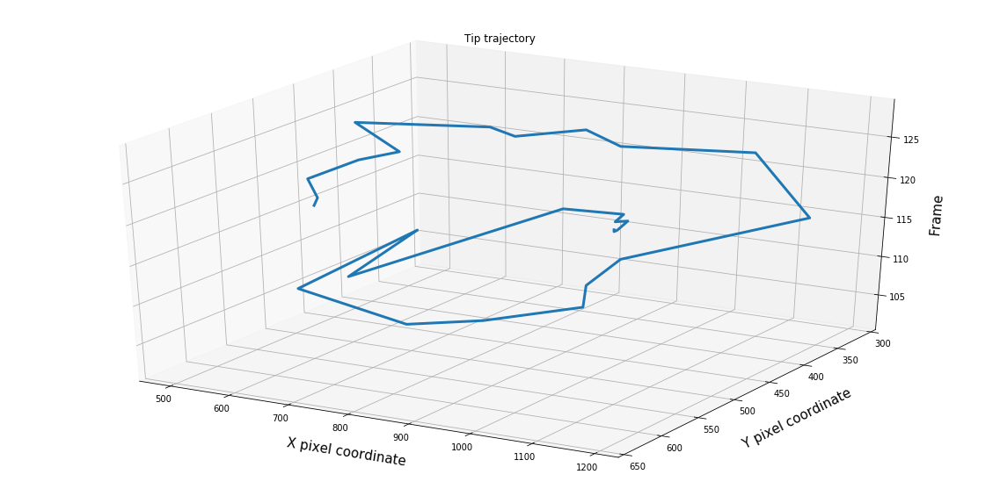

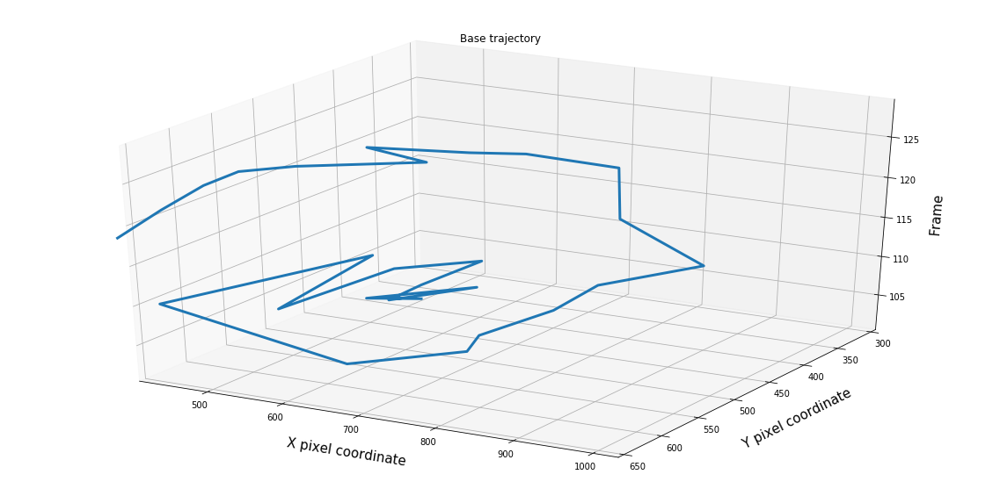

In [93]:
from mpl_toolkits.mplot3d import Axes3D
import matplotlib as mpl
fig = plt.figure(figsize=(20,10))
ax = fig.add_subplot(111, projection='3d')

swing_tip = []
for t in tip:
    if t[2]>SWING_START and t[2]<SWING_END:
        swing_tip.append(t)
swing_tip = np.array(swing_tip)
plt.plot(swing_tip[:,0], swing_tip[:,1], swing_tip[:,2], linewidth=3)
plt.ylim(650,300)
#plt.yticks( fontsize=15)
#plt.xticks(fontsize=15)
#for i in range(5,len(tip)-5):
 #   print(int(tip[i][2]))
#  plt.annotate(int(tip[i][2]), (tip[:,0][i], tip[:,1][i]), label="frame nr")
plt.xlabel("X pixel coordinate", fontsize=15, labelpad=20)
plt.ylabel("Y pixel coordinate", fontsize=15, labelpad=20)
ax.set_zlabel('Frame', fontsize=15, labelpad=10)
plt.title("Tip trajectory")
plt.show()

fig = plt.figure(figsize=(20,10))
ax = fig.add_subplot(111, projection='3d')

swing_base = []
for t in base:
    if t[2]>SWING_START and t[2]<SWING_END:
        swing_base.append(t)
swing_base = np.array(swing_base)

plt.plot(swing_base[:,0], swing_base[:,1], swing_base[:,2], linewidth=3)
plt.ylim(650,300)
#plt.yticks( fontsize=15)
#plt.xticks(fontsize=15)
#for i in range(5,len(tip)-5):
 #   print(int(tip[i][2]))
#  plt.annotate(int(tip[i][2]), (tip[:,0][i], tip[:,1][i]), label="frame nr")
plt.xlabel("X pixel coordinate", fontsize=15, labelpad=20)
plt.ylabel("Y pixel coordinate", fontsize=15, labelpad=20)
ax.set_zlabel('Frame', fontsize=15, labelpad=10)
plt.title("Base trajectory")
plt.show()

## Test ellipse fitting (unfinished)

In [119]:
def fitEllipse(x,y):
    x = x[:,np.newaxis]
    y = y[:,np.newaxis]
    D =  np.hstack((x*x, x*y, y*y, x, y, np.ones_like(x)))
    S = np.dot(D.T,D)
    C = np.zeros([6,6])
    C[0,2] = C[2,0] = 2; C[1,1] = -1
    E, V =  np.linalg.eig(np.dot(np.linalg.inv(S), C))
    n = np.argmax(np.abs(E))
    a = V[:,n]
    return a

def ellipse_center(a):
    b,c,d,f,g,a = a[1]/2, a[2], a[3]/2, a[4]/2, a[5], a[0]
    num = b*b-a*c
    x0=(c*d-b*f)/num
    y0=(a*f-b*d)/num
    return np.array([x0,y0])

def ellipse_angle_of_rotation( a ):
    b,c,d,f,g,a = a[1]/2, a[2], a[3]/2, a[4]/2, a[5], a[0]
    return 0.5*np.arctan(2*b/(a-c))

def ellipse_axis_length( a ):
    b,c,d,f,g,a = a[1]/2, a[2], a[3]/2, a[4]/2, a[5], a[0]
    up = 2*(a*f*f+c*d*d+g*b*b-2*b*d*f-a*c*g)
    down1=(b*b-a*c)*( (c-a)*np.sqrt(1+4*b*b/((a-c)*(a-c)))-(c+a))
    down2=(b*b-a*c)*( (a-c)*np.sqrt(1+4*b*b/((a-c)*(a-c)))-(c+a))
    res1=np.sqrt(up/down1)
    res2=np.sqrt(up/down2)
    return np.array([res1, res2])

def find_ellipse(x, y):
    xmean = np.mean(x)
    ymean = np.mean(y)
    x = x.astype(float) - xmean
    y = y.astype(float) - ymean
    a = fitEllipse(x,y)
    center = ellipse_center(a)
    center[0] += xmean
    center[1] += ymean
    phi = ellipse_angle_of_rotation(a)
    axes = ellipse_axis_length(a)
    x += xmean
    y += ymean
    return center, phi, axes


center =  [ 1272.44832041   635.46506808]
angle of rotation =  0.207087734156
axes =  [ 298.45409168           nan]


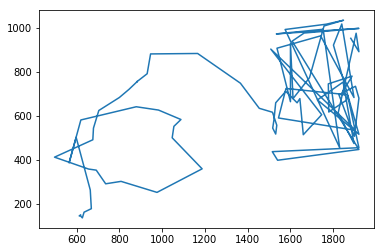

In [120]:
def bestEll(points):
    # fig, axs = plt.subplots(2, 1, sharex = True, sharey = True)
    a_points = np.array(points)
    x = a_points[:, 0]
    y = a_points[:, 1]
    # axs[0].plot(x,y)
    center, phi, axes = find_ellipse(x, y)
    print("center = ",  center)
    print("angle of rotation = ",  phi)
    print("axes = ", axes)

    # axs[1].plot(x, y)
    # axs[1].scatter(center[0],center[1], color = 'red', s = 100)
    # axs[1].set_xlim(x.min(), x.max())
    # axs[1].set_ylim(y.min(), y.max())

    arc = 2
    a, b = axes
    ells = []
    RS = np.arange(0,arc*np.pi, 0.01)
    for R in RS:
    # x = 1.5*np.cos(R) + 2 + 0.1*np.random.rand(len(R))
    # y = np.sin(R) + 1. + 0.1*np.random.rand(len(R))
        ells.append([center[0] + a*np.cos(R)*np.cos(phi) - b*np.sin(R)*np.sin(phi), center[1] + a*np.cos(R)*np.sin(phi) + b*np.sin(R)*np.cos(phi)])
#     xx = center[0] + a*np.cos(R)*np.cos(phi) - b*np.sin(R)*np.sin(phi)
#     yy = center[1] + a*np.cos(R)*np.sin(phi) + b*np.sin(R)*np.cos(phi)
    
    ells = np.array(ells)
    plt.plot(x,y)
    #plt.plot(xs,ys, color = 'blue')
    plt.plot(ells[:,0],ells[:,1], color = 'red')
    # plt.ylim(650,300)
    plt.show()
    
#     print ells
#     print tip[:,:2]
    return ells
    
points = tip[:,:2]
ell= bestEll(points)